In [1]:
import pandas as pd

import os

import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
os.getcwd()

'/Users/dawid/Documents/hubquest_taxi/notebooks'

In [30]:
# from pathlib import Path

# def get_root_path():
#     return Path(__file__).parent.parent

def get_raw_data_path():
    return "../" + "data/" + "raw/"

In [31]:
df = pd.read_parquet(get_raw_data_path() + "final_taxi_data.parquet")

In [32]:
df.shape

(100594, 19)

In [33]:
df.head()

,passenger_count,trip_distance,pickup_longitude,pickup_latitude,ratecodeid,store_and_fwd_flag,dropoff_longitude,dropoff_latitude,fare_amount,extra,mta_tax,tip_amount,tolls_amount,total_amount,vendor_id,pickup_datetime,dropoff_datetime,payment_type,imp_surcharge
0,1,1.00,-73.962883,40.766521,1,N,-73.975868,40.763676,6.0,0.0,0.5,1.00,0.0,7.80,1,2015-08-26 06:35:08,2015-08-26 06:40:55,1,0.3
1,1,1.15,-74.006599,40.744186,1,N,-73.994347,40.754211,6.5,0.0,0.5,0.00,0.0,7.30,2,2015-08-22 17:25:04,2015-08-22 17:31:04,2,0.3
2,6,3.00,-73.989113,40.758263,1,N,-73.992310,40.725040,15.0,1.0,0.5,3.36,0.0,20.16,2,2015-08-25 17:07:03,2015-08-25 17:28:22,1,0.3
3,1,1.11,-73.994087,40.751228,1,N,-73.981529,40.758717,11.0,0.0,0.5,2.95,0.0,14.75,2,2015-08-03 11:32:22,2015-08-03 11:48:59,1,0.3
4,2,2.34,-73.982079,40.746006,1,N,-73.962326,40.774628,11.0,0.5,0.5,3.08,0.0,15.38,2,2015-08-07 21:33:16,2015-08-07 21:44:54,1,0.3


In [34]:
df.isna().sum() / df.shape[0]

passenger_count       0.0
trip_distance         0.0
pickup_longitude      0.0
pickup_latitude       0.0
ratecodeid            0.0
store_and_fwd_flag    0.0
dropoff_longitude     0.0
dropoff_latitude      0.0
fare_amount           0.0
extra                 0.0
mta_tax               0.0
tip_amount            0.0
tolls_amount          0.0
total_amount          0.0
vendor_id             0.0
pickup_datetime       0.0
dropoff_datetime      0.0
payment_type          0.0
imp_surcharge         0.0
dtype: float64

In [35]:
def basic_stats(column_name):
    
    print(f"\n\n\nVariable name: {column_name}\n\n")
    x = df[column_name]
    
    print(f"max value: {x.max()}")
    print(f"min value: {x.min()}")
    
    if len(x.unique()) < 10:
        print(f"Frequency: {x.value_counts()}")
    
    
    sns.boxplot(x)
    plt.show()
    sns.histplot(x)
    plt.show()
    sns.scatterplot(data=df, x='pickup_datetime', y=column_name)
    plt.show()

In [36]:
# for col in df.columns:
#     try:
#         basic_stats(col)
#     except:
#         pass

In [37]:
df['store_and_fwd_flag'].value_counts()

store_and_fwd_flag
N    99852
Y      742
Name: count, dtype: int64

In [38]:
df['trip_distance'].describe()

count    100594.000000
mean          3.109172
std           3.843871
min           0.000000
25%           1.050000
50%           1.800000
75%           3.340000
max         170.500000
Name: trip_distance, dtype: float64

In [39]:
df['trip_distance'].quantile(0.99)

18.81999969482422

Variables annotations:

    - passenger_count:
        - value 0 to be removed
        
    - trip_distance:
        - 99% of obs < value of 20 -- could be cut off
        
    - pickup_longitude:
        - remove 0 (keep only range of NYC destination)
        
    - pickup_latitude:
        - remove 0 (keep only range of NYC destination)
        
    - ratecodeid:
        - remove values of 6 and 99
        
    - store_and_fwd_flag: does it matter?
    
    - dropoff_longitude:
            - remove 0 (keep only range of NYC destination)

    - dropoff_latitude:
            - remove 0 (keep only range of NYC destination)
            
    - fare_amount:
            - why negative?
            
    - total_amount:
            - why negative?
      
    - payment_type: remove 3, 4

In [40]:
# data manipulations
print(df.shape)

df = df[df['passenger_count'] != 0]
df = df[df['trip_distance'] <= 20]
df = df[df['pickup_longitude'] <= -70]
df = df[df['pickup_latitude'] >= 40]
df = df[df['ratecodeid'].isin([1, 2, 3, 4, 5])]
df = df[df['dropoff_longitude'] <= -70]
df = df[df['dropoff_latitude'] >= 40]
df = df[(df['fare_amount'] > 0) & (df['fare_amount'] <= 100)]
df = df[(df['total_amount'] > 0) & (df['total_amount'] <= 100)]
df = df[df['payment_type'].isin([1, 2])]

print(df.shape)

(100594, 19)
(97917, 19)


In [41]:
# for col in df.columns:
#     try:
#         basic_stats(col)
#     except:
#         pass

<Axes: >

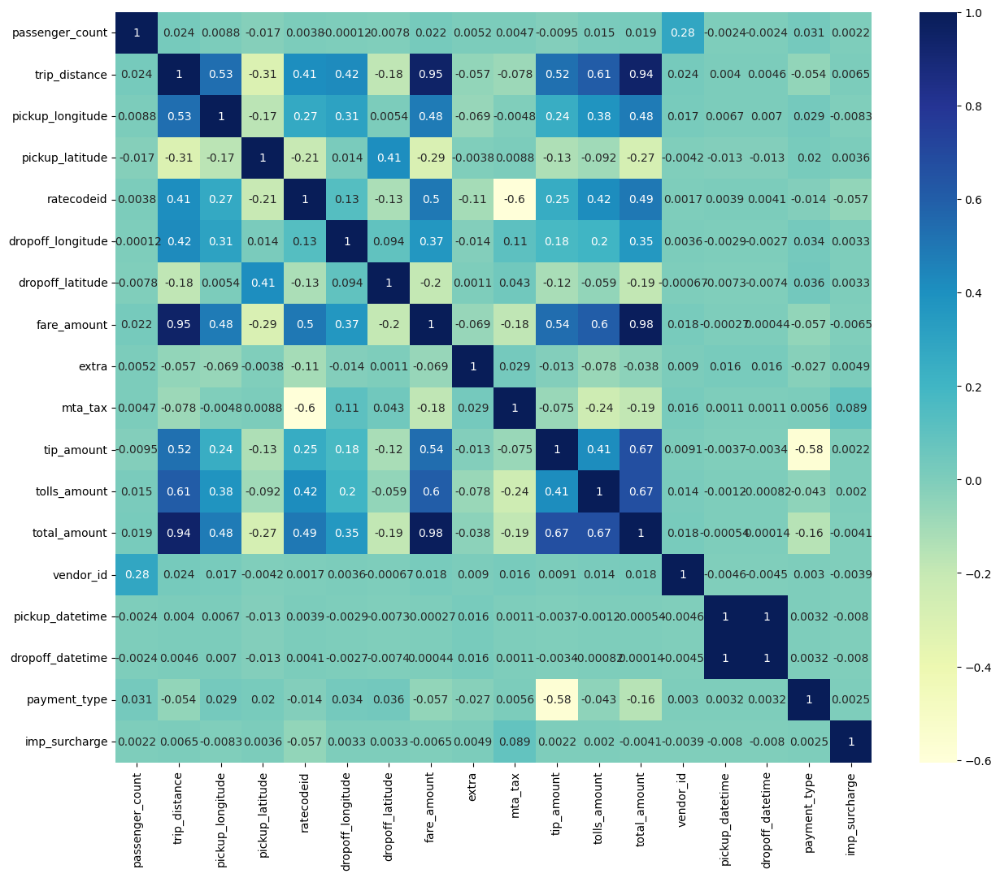

In [42]:
plt.figure(figsize=(15, 12))
sns.heatmap(df.drop(columns="store_and_fwd_flag").corr(), cmap="YlGnBu", annot=True) 

<Axes: xlabel='pickup_longitude', ylabel='pickup_latitude'>

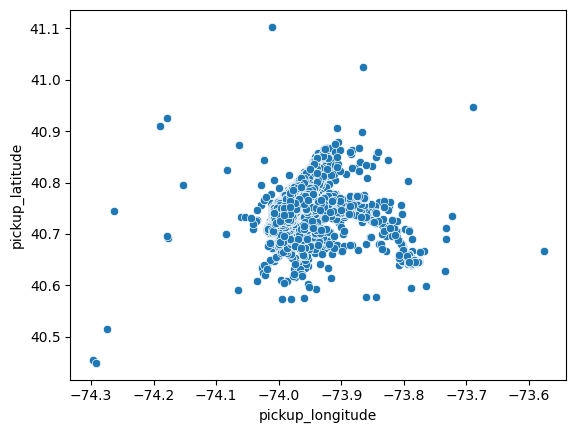

In [43]:
sns.scatterplot(data=df, x='pickup_longitude', y='pickup_latitude')

<Axes: xlabel='dropoff_longitude', ylabel='dropoff_latitude'>

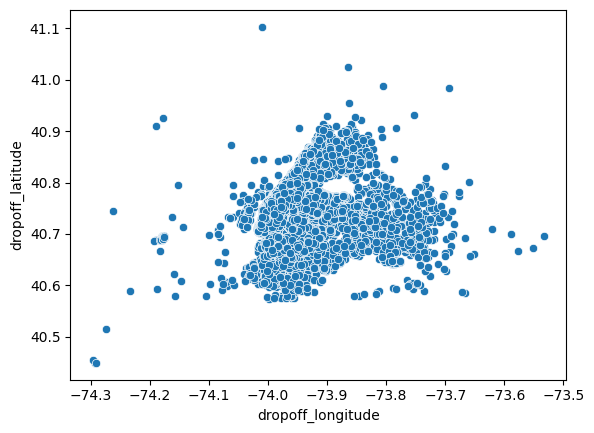

In [44]:
sns.scatterplot(data=df, x='dropoff_longitude', y='dropoff_latitude')

In [11]:
# plotly maps
import plotly.express as px

px.set_mapbox_access_token(
    "pk.eyJ1IjoiZHhrMDExMSIsImEiOiJjbG5rMnZiMWcwajR4MmpzMzBtbWh4MzUxIn0.Awp5L80wu7nmpdGvOoCunw"
)

In [46]:
fig = px.scatter_mapbox(
    df,
    lat="pickup_latitude",
    lon="pickup_longitude",
    color="fare_amount",
#     size="payment_type",
    size_max=4,
)
fig.show()

In [47]:
fig2 = px.scatter_mapbox(
    df,
    lat="dropoff_latitude",
    lon="dropoff_longitude",
    color="fare_amount",
#     size="payment_type",
    size_max=4,
)
fig2.show()

In [48]:
# trip distance prediction based on pickup and dropoff distance metrics

# https://docs.scipy.org/doc/scipy/reference/spatial.distance.html

## Clustering based on lat long

In [14]:
from sklearn.cluster import KMeans

import warnings
warnings.filterwarnings('ignore')

In [3]:
# read split and clean data

In [8]:
df = pd.read_parquet("../data/processed/train_data_processed.parquet")

In [26]:
df_cluster = pd.concat(
    [
        df[["pickup_longitude", "pickup_latitude"]].rename(
            columns={"pickup_longitude": "longitude", "pickup_latitude": "latitude"}
        ),
        df[["dropoff_longitude", "dropoff_latitude"]].rename(
            columns={"dropoff_longitude": "longitude", "dropoff_latitude": "latitude"}
        ),
    ],
    axis=0,
    ignore_index=True,
)
print(df_cluster.shape)
df_cluster.head()

(115886, 2)


,longitude,latitude
0,-73.990479,40.750092
1,-74.008583,40.719704
2,-73.946808,40.776146
3,-73.994316,40.746120
4,-73.988503,40.718513


In [15]:
fig = px.scatter_mapbox(
    df_cluster,
    lat="latitude",
    lon="longitude",
    size_max=4,
)
fig.show()

In [16]:
from sklearn.metrics import silhouette_score

df1 = df_cluster.sample(10000)
s_scores = []
no_clusters = []

for n_clusters in range(2, 100):
    clusterer = KMeans(n_clusters=n_clusters)
    preds = clusterer.fit_predict(df1)

    score = silhouette_score(df1, preds)
    s_scores.append(score)
    no_clusters.append(n_clusters)

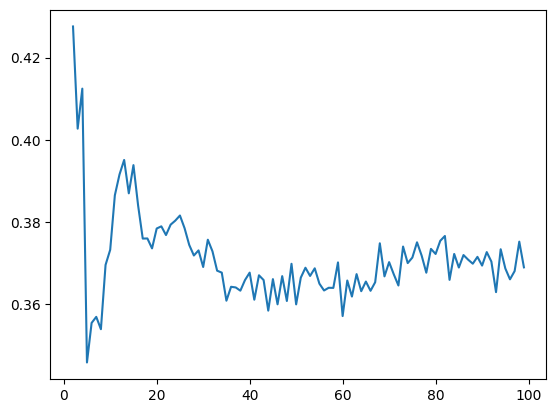

In [17]:
plt.plot(no_clusters, s_scores);

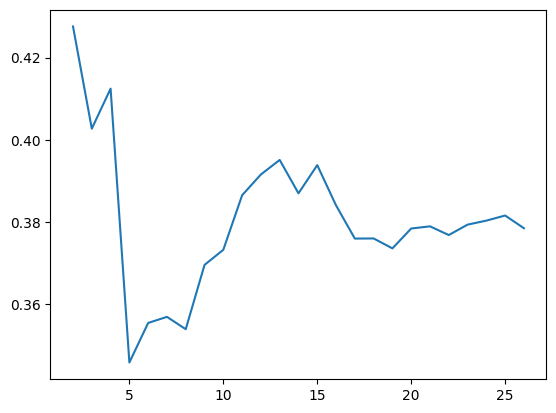

In [18]:
plt.plot(no_clusters[:25], s_scores[:25]);

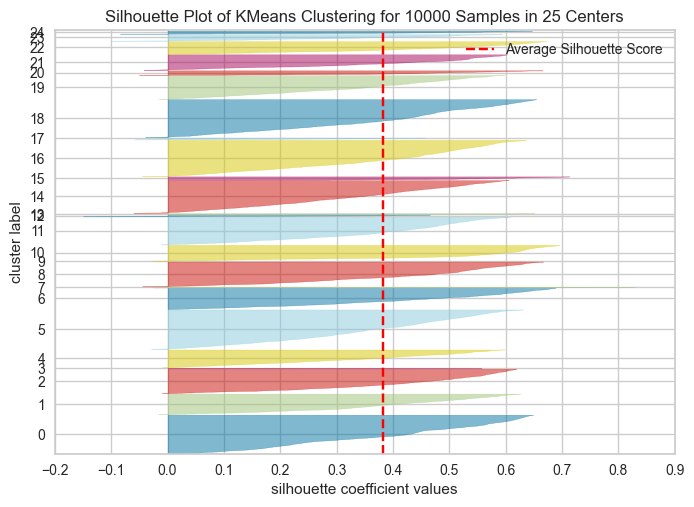

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 10000 Samples in 25 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [19]:
from yellowbrick.cluster import SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = KMeans(25, random_state=42)
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(df_cluster.sample(10000))        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

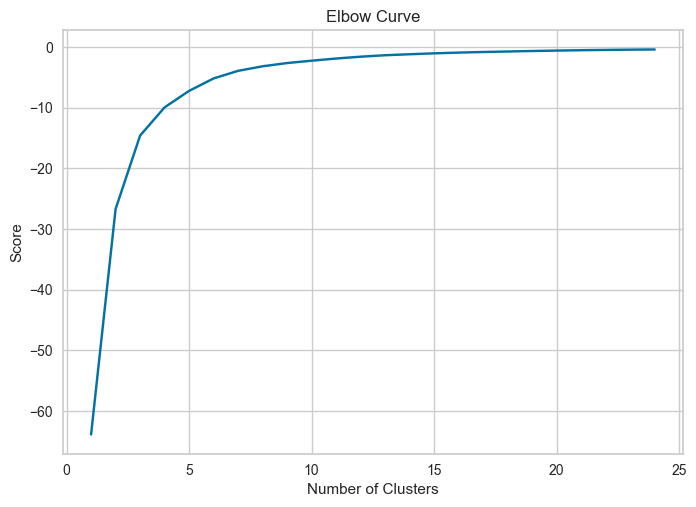

In [20]:
K_clusters = range(1,25)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]
Y_axis = df_cluster[['latitude']]
X_axis = df_cluster[['longitude']]
score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]
# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

In [24]:
df_cluster.iloc[:, :2]

,longitude,latitude
0,-73.990479,40.750092
1,-74.008583,40.719704
2,-73.946808,40.776146
3,-73.994316,40.746120
4,-73.988503,40.718513
...,...,...
115881,-73.982185,40.756977
115882,-73.975288,40.761234
115883,-73.979752,40.727158
115884,-73.980278,40.765671


In [27]:
kmeans = KMeans(n_clusters=15, init="k-means++")
kmeans.fit(df_cluster.iloc[:, :2])  # Compute k-means clustering.
df_cluster["cluster_label"] = kmeans.fit_predict(df_cluster)

centers = kmeans.cluster_centers_  # Coordinates of cluster centers.
labels = kmeans.predict(df_cluster.iloc[:, :2])  # Labels of each point
df_cluster.head(10)

,longitude,latitude,cluster_label
0,-73.990479,40.750092,3
1,-74.008583,40.719704,8
2,-73.946808,40.776146,2
3,-73.994316,40.746120,12
4,-73.988503,40.718513,0
5,-73.998245,40.726261,0
6,-73.992447,40.745197,9
7,-73.984940,40.736649,9
8,-73.988747,40.736851,9
9,-73.980606,40.733994,9


In [28]:
fig = px.scatter_mapbox(
    df_cluster,
    lat="latitude",
    lon="longitude",
    size_max=4,
    color='cluster_label',
)
fig.write_html("clustered_map_taxi.html")
fig.show()

## Clustering based on trip info

In [3]:
from sklearn.cluster import KMeans

import warnings
warnings.filterwarnings('ignore')

In [6]:
df = pd.read_parquet("../data/processed/train_data_processed.parquet")

In [9]:
cols =     [
        "pickup_longitude",
        "pickup_latitude",
        "ratecodeid",
        "dropoff_longitude",
        "dropoff_latitude",
    ]


In [10]:
from sklearn.metrics import silhouette_score

df1 = df[cols].sample(10000)
s_scores = []
no_clusters = []

for n_clusters in range(2, 100):
    clusterer = KMeans(n_clusters=n_clusters)
    preds = clusterer.fit_predict(df1)

    score = silhouette_score(df1, preds)
    s_scores.append(score)
    no_clusters.append(n_clusters)

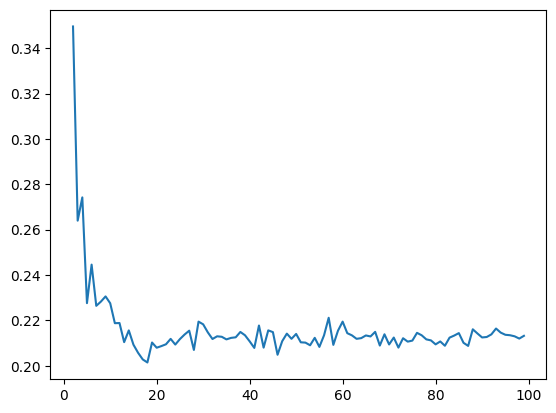

In [11]:
plt.plot(no_clusters, s_scores);

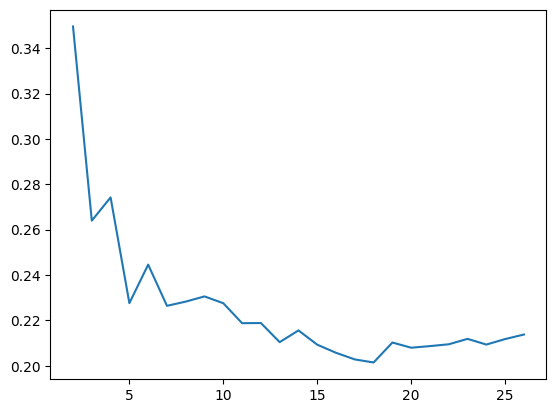

In [12]:
plt.plot(no_clusters[:25], s_scores[:25]);

In [22]:
from scipy.spatial import distance

In [23]:
metrics = ['braycurtis', 'chebyshev', 'cityblock', 'cosine', 'euclidean',
          'jensenshannon', 'minkowski', 'sqeuclidean']

In [28]:
df['distance.braycurtis'] = df.apply(
    lambda row: distance.braycurtis(
        [row["pickup_latitude"], row["pickup_longitude"]],
        [row["dropoff_longitude"], row["dropoff_latitude"]],
    ),
    axis=1,
)

In [29]:
# df['distance.canberra'] = df.apply(
#     lambda row: distance.canberra(
#         [row["pickup_latitude"], row["pickup_longitude"]],
#         [row["dropoff_longitude"], row["dropoff_latitude"]],
#     ),
#     axis=1,
# )

In [30]:
df['distance.chebyshev'] = df.apply(
    lambda row: distance.chebyshev(
        [row["pickup_latitude"], row["pickup_longitude"]],
        [row["dropoff_longitude"], row["dropoff_latitude"]],
    ),
    axis=1,
)

In [31]:
df['distance.cityblock'] = df.apply(
    lambda row: distance.cityblock(
        [row["pickup_latitude"], row["pickup_longitude"]],
        [row["dropoff_longitude"], row["dropoff_latitude"]],
    ),
    axis=1,
)

In [32]:
df['distance.cosine'] = df.apply(
    lambda row: distance.cosine(
        [row["pickup_latitude"], row["pickup_longitude"]],
        [row["dropoff_longitude"], row["dropoff_latitude"]],
    ),
    axis=1,
)

In [33]:
df['distance.euclidean'] = df.apply(
    lambda row: distance.euclidean(
        [row["pickup_latitude"], row["pickup_longitude"]],
        [row["dropoff_longitude"], row["dropoff_latitude"]],
    ),
    axis=1,
)

In [34]:
df['distance.jensenshannon'] = df.apply(
    lambda row: distance.jensenshannon(
        [row["pickup_latitude"], row["pickup_longitude"]],
        [row["dropoff_longitude"], row["dropoff_latitude"]],
    ),
    axis=1,
)

In [35]:
df['distance.minkowski'] = df.apply(
    lambda row: distance.minkowski(
        [row["pickup_latitude"], row["pickup_longitude"]],
        [row["dropoff_longitude"], row["dropoff_latitude"]],
    ),
    axis=1,
)

In [36]:
df['distance.sqeuclidean'] = df.apply(
    lambda row: distance.sqeuclidean(
        [row["pickup_latitude"], row["pickup_longitude"]],
        [row["dropoff_longitude"], row["dropoff_latitude"]],
    ),
    axis=1,
)

In [40]:
from haversine import haversine, Unit

df["distance.haversine"] = df.apply(
    lambda x: haversine(
        (x["pickup_latitude"], x["pickup_longitude"]),
        (x["dropoff_latitude"], x["dropoff_longitude"]),
        unit=Unit.KILOMETERS,
    ),
    axis=1,
)
df["trip_haversine_miles"] = df.apply(
    lambda x: haversine(
        (x["pickup_latitude"], x["pickup_longitude"]),
        (x["dropoff_latitude"], x["dropoff_longitude"]),
        unit=Unit.MILES,
    ),
    axis=1,
)

In [41]:
df_distance = df[
    [
        "trip_distance",
        "distance.braycurtis",
#         "distance.canberra",
        "distance.chebyshev",
        "distance.cityblock",
        "distance.cosine",
        "distance.euclidean",
#         "distance.jensenshannon",
#         "distance.minkowski",
        "distance.sqeuclidean",
#         "trip_haversine_miles",
        "distance.haversine"
    ]
]

<Axes: >

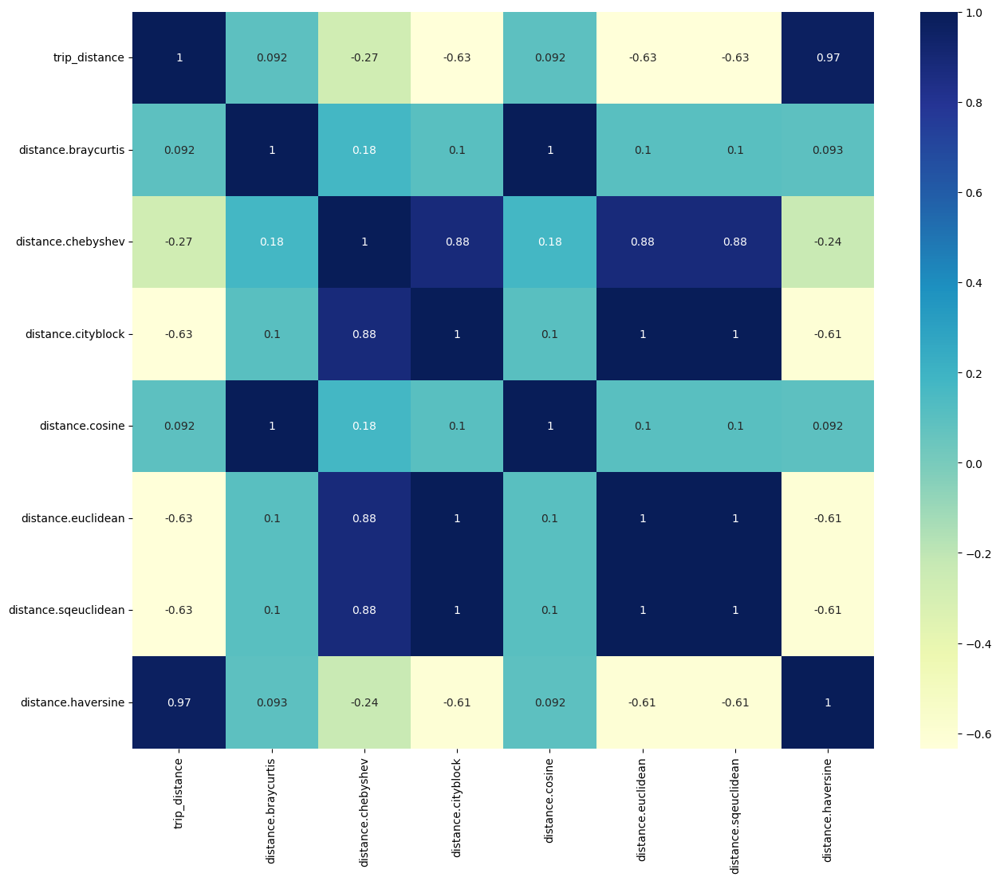

In [42]:
plt.figure(figsize=(15, 12))
sns.heatmap(df_distance.corr(), cmap="YlGnBu", annot=True) 

In [43]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

X = df_distance.drop(columns='trip_distance')
y = df_distance['trip_distance']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25)

regr = LinearRegression()
regr.fit(X_train, y_train)

LinearRegression()

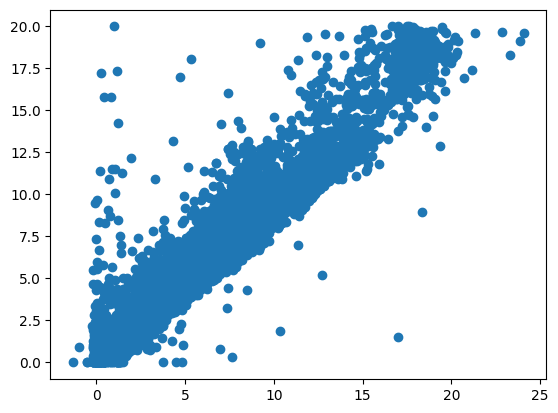

In [44]:
y_pred = regr.predict(X_test)

plt.scatter(y_pred, y_test)
plt.show()

In [45]:
from sklearn.metrics import r2_score
r2 = r2_score(y_test, y_pred)

print("R2 score:", r2)

R2 score: 0.9416242786137158


In [ ]:
# trip distance based on pickup and dropoff location and time

# variables based on geo-clusters and datetime based features